## A tool to explore and analyze the CalTech Pedestrian dataset

In [1]:
#Import dependent modules
import matplotlib.pyplot as plt
import numpy as np
import os, sys, cv2
import random
import json
%matplotlib inline


In [2]:
#Load necessary data

#There are four kinds of label in CalTech Pedestrian data set
label_set = {'person', 'people', 'person-fa', 'person?'}  

#Load the ground truth annotation. You shold specify the file path of json ground truth
annotation_path = "/root/data/caltech-pedestrian-dataset-converter/data/annotations.json"
gt_annotation = json.load(open(annotation_path ))

In [3]:
#Declare tool functions 

#Get the data of the frames that contain the valid bboxes. You can specify the box_filter to filter out boxes
#This function returns a tuple: frame_name & bboxes
def get_frames(gt_annotation, box_filter=None):

    target_frames = []
    for set_num, set_annotation in gt_annotation.items():
        for v_num, v_annotation in set_annotation.items():
            for frame_num, boxes in v_annotation["frames"].items():
                filtered_box = [box for box in boxes if box_filter is None or box_filter(box) ]
                
                #Only the the frames contain valid boxes are returned
                if len(filtered_box) > 0:
                    frame_name = "{}_{}_{}.jpg".format(set_num, v_num, frame_num)
                    target_frames.append((frame_name, filtered_box))
                      
    return target_frames


#For boxes with "Person" Label
def person_filter(box):
    return box['lbl'] == 'person'

#For boxes with a specified boundry, the default values arefrom 
def boundry_filter(box, bnds = {'xmin':5, 'ymin':5, 'xmax':635, 'ymax':475}):
    x1 = box['pos'][0]
    y1 = box['pos'][1]
    width = box['pos'][2]
    height = box['pos'][3]
    x2 = x1 + width
    y2 = y1 + height
    
    validity =  x1 >= bnds['xmin'] and \
                x2 <= bnds['xmax'] and \
                y1 >= bnds['ymin'] and \
                y2 <= bnds['ymax'] 
                
    return validity
    
#For boxes higher than a speifcied height
def height_filter(box, height_range = {'min':50, 'max': float('inf')}):
    height = box['pos'][3]
    validity = height >= height_range['min'] and \
               height < height_range['max']
    return validity

#For boxes more visible than a speifcied range
def visibility_filter(box, visible_range = {'min': 0.65, 'max': float('inf')}):
    occluded = box['occl']
    
    #A dirty condition to deal with the ill-formatted data.
    if occluded == 0 or \
       not hasattr(box['posv'], '__iter__') or \
       all([v==0 for v in box['posv']]):
           
        visiable_ratio = 1
    
    else:
        width = box['pos'][2]
        height = box['pos'][3]
        area = width * height   
           
        visible_width = box['posv'][2]
        visible_height = box['posv'][3]
        visible_area = visible_width * visible_height
           
        visiable_ratio = visible_area / area
           
           
           
    validity = visiable_ratio  >= visible_range['min'] and \
           visiable_ratio  <= visible_range['max']
           
    return validity

        
                                              
                                                                    
                                        
    height = box['pos'][3]
    validity = height >= height_range['min'] and \
               height < height_range['max']
    return validity
    

            

def reasonable_filter(box):
    validity = person_filter(box) and\
               boundry_filter(box) and\
               height_filter(box) and \
               visibility_filter(box)
           
    return validity


def aspect_ration_filter(box, AR_ratio = {"min": 0, "max": float("inf")}):
    height = box['pos'][3] 
    width = box['pos'][2]
    aspect_ratio = (width / height)
                                          
    return  aspect_ratio >= AR_ratio["min"] and aspect_ratio < AR_ratio["max"]

def get_boxes(gt_annotation, frame_name):
    set_num, v_num, frame_num = frame_name[:-4].split("_")
    return gt_annotation[set_num][v_num]["frames"][frame_num]



In [4]:
reasonable_frames = get_frames(gt_annotation, reasonable_filter)
print("There are {} reasonable frames".format(len(reasonable_frames)))



There are 47816 reasonable frames


In [5]:
#A function that renders the image with bounding boxes
def render_frame(frame_name, boxes, compare_boxes = []):
    #You probably need to change the file path.
    images_path = "/root/data/caltech-pedestrian-dataset-converter/data/images"
    
    frame_path = os.path.join(images_path, frame_name)
    im = cv2.imread(frame_path)[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(im, aspect='equal')
    
    label_to_color = {"people": "red", "person": "green", "person-fa": "blue", "person?": "yellow"}
    
  
    
    for box in boxes:
        x1 = box['pos'][0]
        y1 = box['pos'][1]
        width = box['pos'][2]
        length = box['pos'][3]
        label = box['lbl']
        color = label_to_color[label]
        rectangle = plt.Rectangle((x1,y1), width,length, fill=False, edgecolor=color, linewidth=3.5)
        ax.add_patch(rectangle)
        ax.text(x1, y1 - 2, label,
                bbox=dict(facecolor=color, alpha=0.5),
                fontsize=14, color='white')
        
        
      
    for box in compare_boxes:
        x1 = box['pos'][0]
        y1 = box['pos'][1]
        width = box['pos'][2]
        length = box['pos'][3]
        label = box['lbl']
        color = label_to_color[label]
        rectangle = plt.Rectangle((x1,y1), width,length, fill=False, edgecolor=color, linewidth=3.5,  \
                                  linestyle='dashed')
        ax.add_patch(rectangle)
        ax.text(x1, y1 - 2, label,
                bbox=dict(facecolor=color, alpha=0.5),
                fontsize=14, color='white')
            
    
    ax.set_title(frame_name)  
    plt.axis('off')
    plt.tight_layout()
    plt.draw()
        
    

In [6]:
#Apply the specified box_filter and verify it by rendering N images with the filtered bounding boxes
#A comparing filter can also be applied. The boxes from the comparing filter are dotted lines.
def verify_filter(box_filter,compare_filter=None , N=3, gt_annotation=gt_annotation):
    frames = get_frames(gt_annotation, box_filter)
    bbox_count = 0
    for _, bboxes in frames:
        bbox_count += len(bboxes)
    
    
    print("{} frames and {} bbox".format(len(frames), bbox_count))
    sampled_indices =  random.sample(range(len(frames)) ,N)

    #Render the selected images
    for sampled_index in sampled_indices :

        frame_name, boxes = frames[sampled_index]
        
        if compare_filter is None:
            render_frame(frame_name, boxes)
            
        else:
            
            raw_boxes = get_boxes(gt_annotation, frame_name)
            compare_boxes = [box for box in raw_boxes if compare_filter(box)]
            render_frame(frame_name, boxes, compare_boxes)


    

79 frames and 79 bbox


/usr/local/lib/python2.7/dist-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


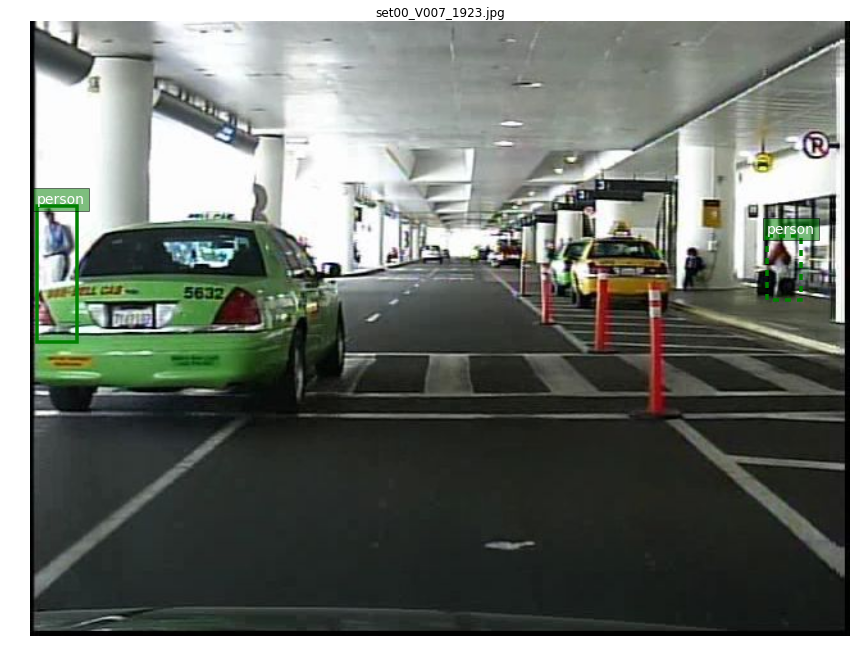

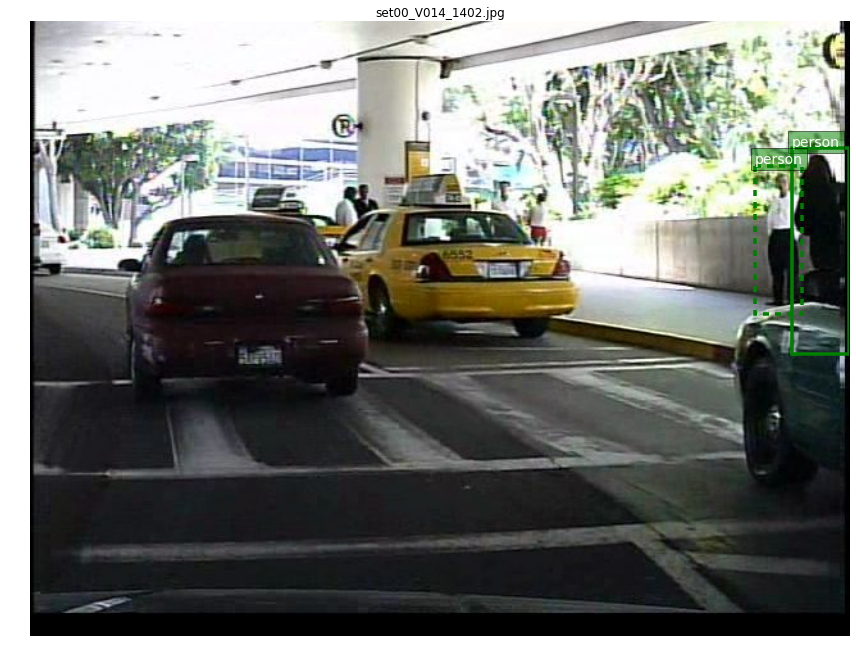

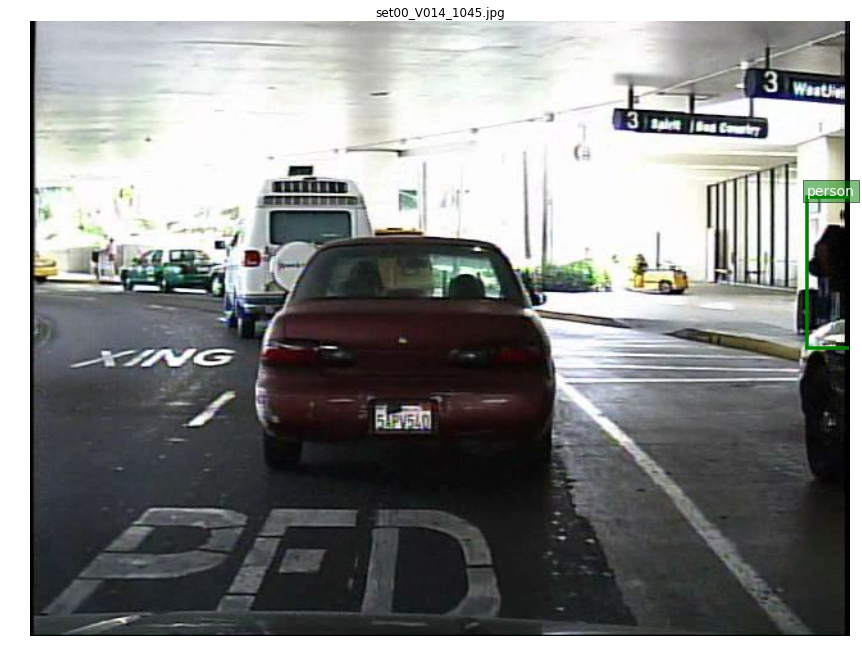

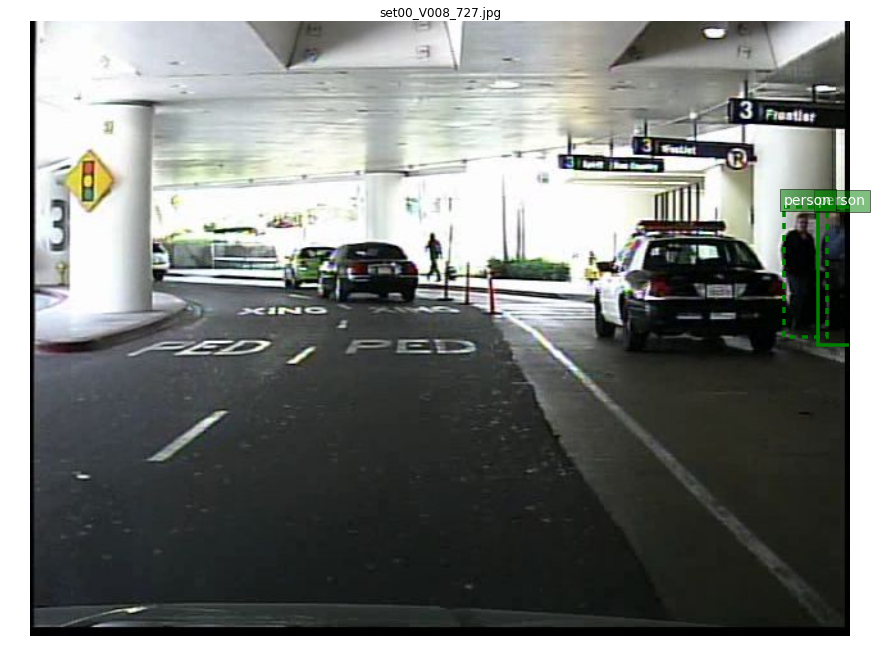

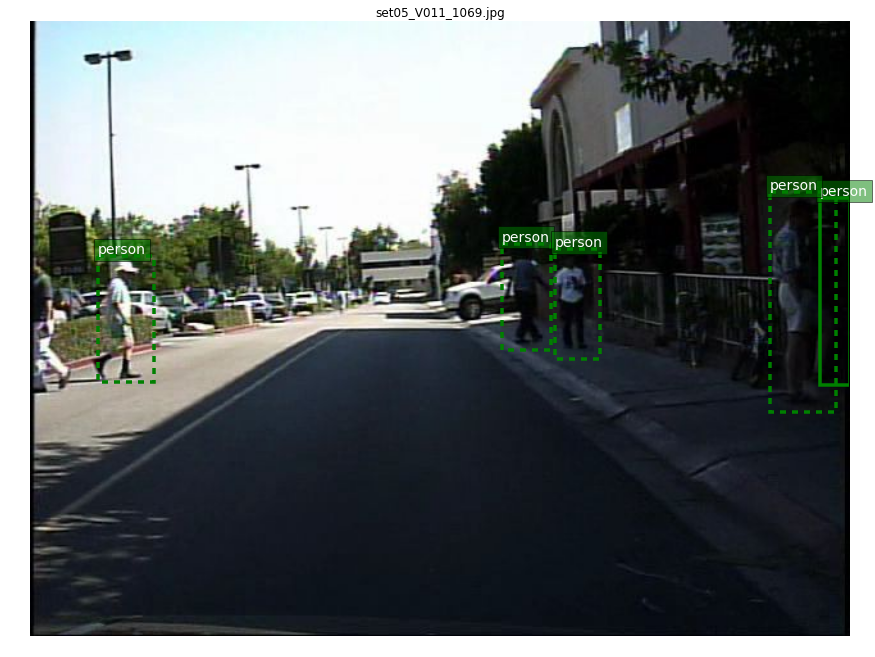

...

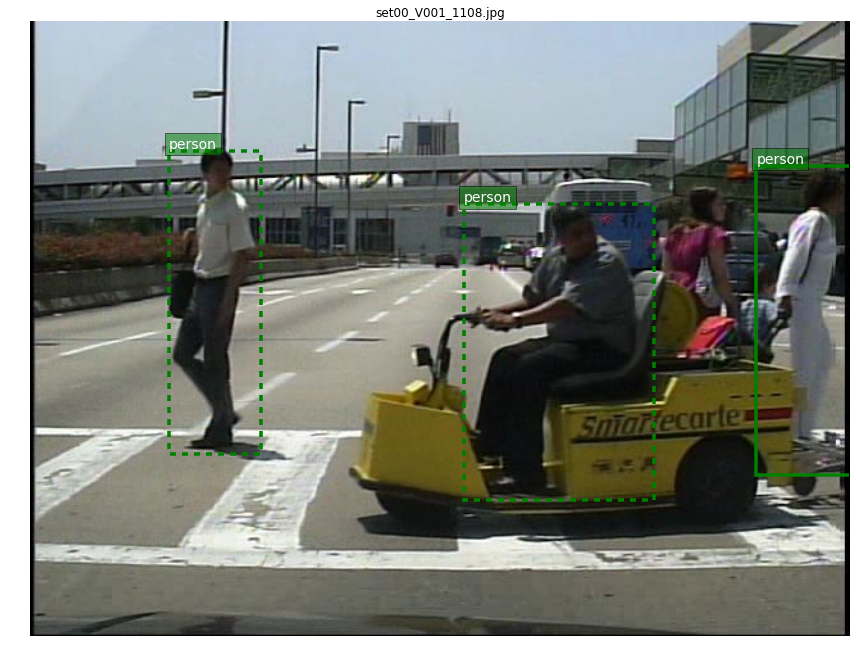

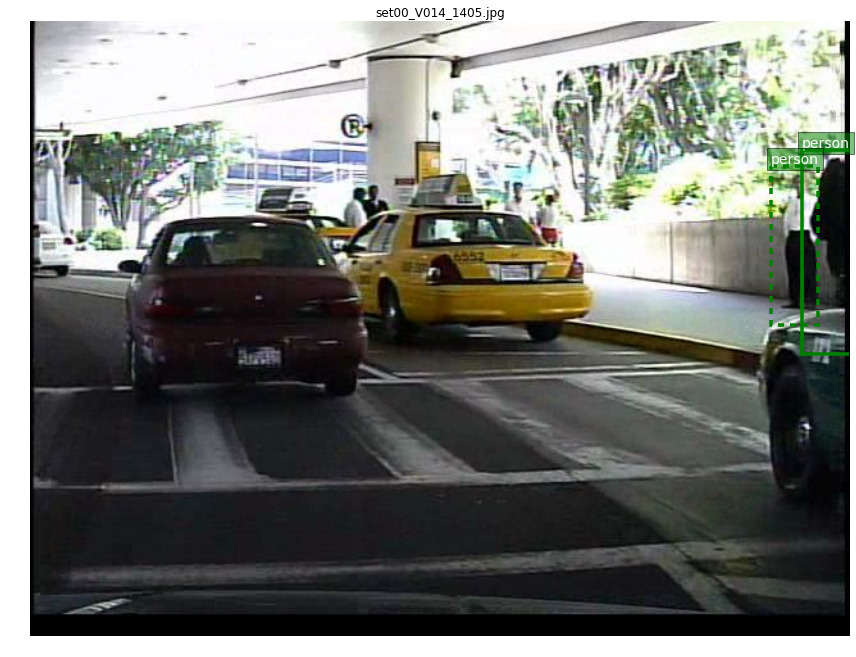

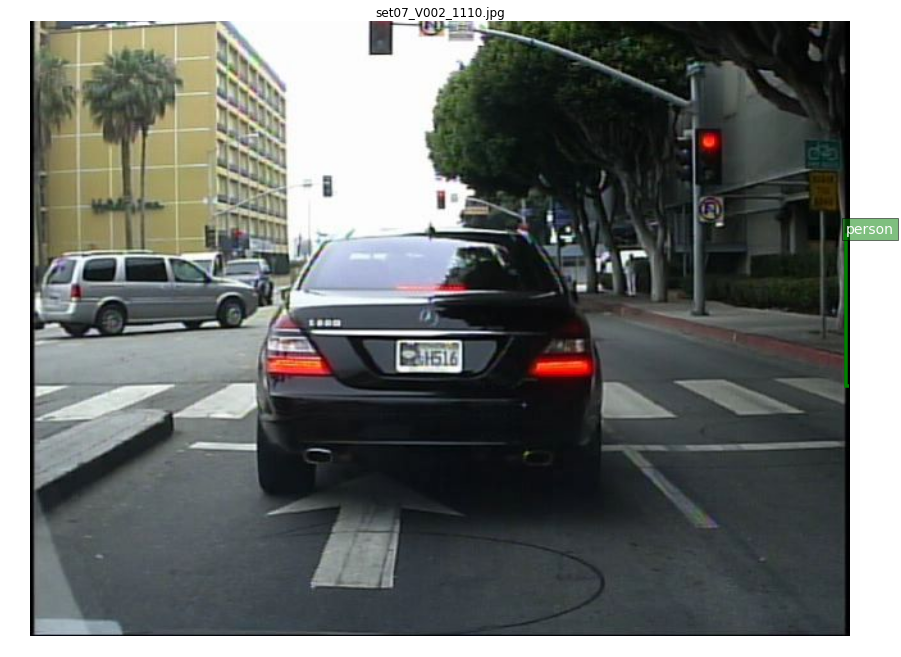

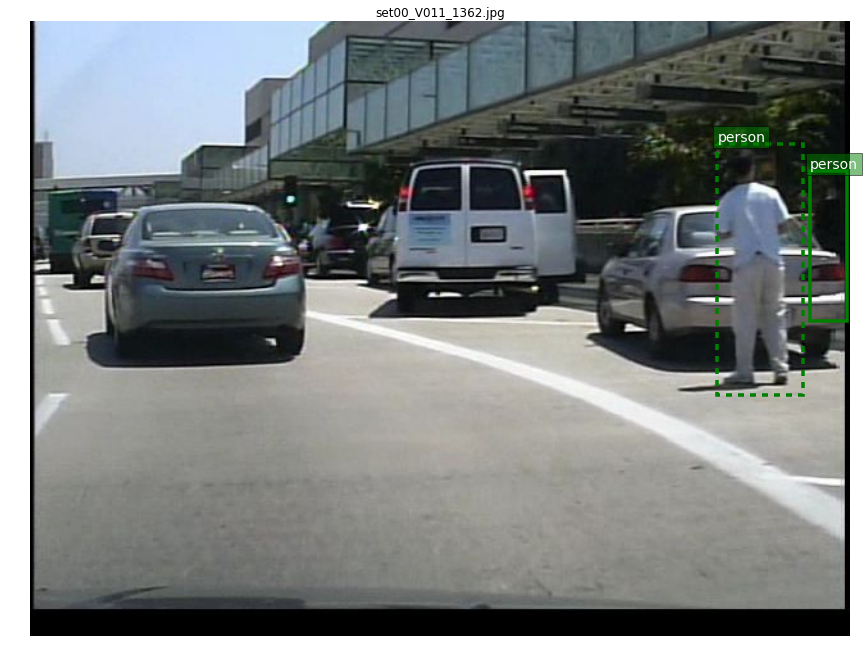

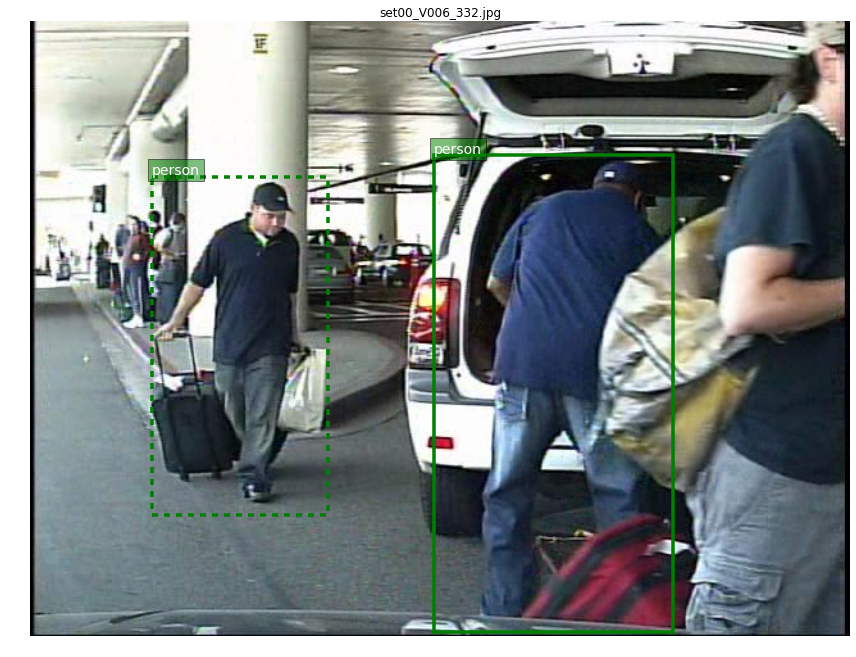

In [7]:
def big_filter(box, lower_bounds = [50,100]):
    height = box['pos'][3] 
    width = box['pos'][2] 
    return height > lower_bounds[1]

def occul_big(box):
    visible_range = {'min': 0.5, 'max': 0.65}
    return visibility_filter(box, visible_range) and not boundry_filter(box) and big_filter(box)
                                          

verify_filter(occul_big, reasonable_filter, N=30)

670 frames and 692 bbox


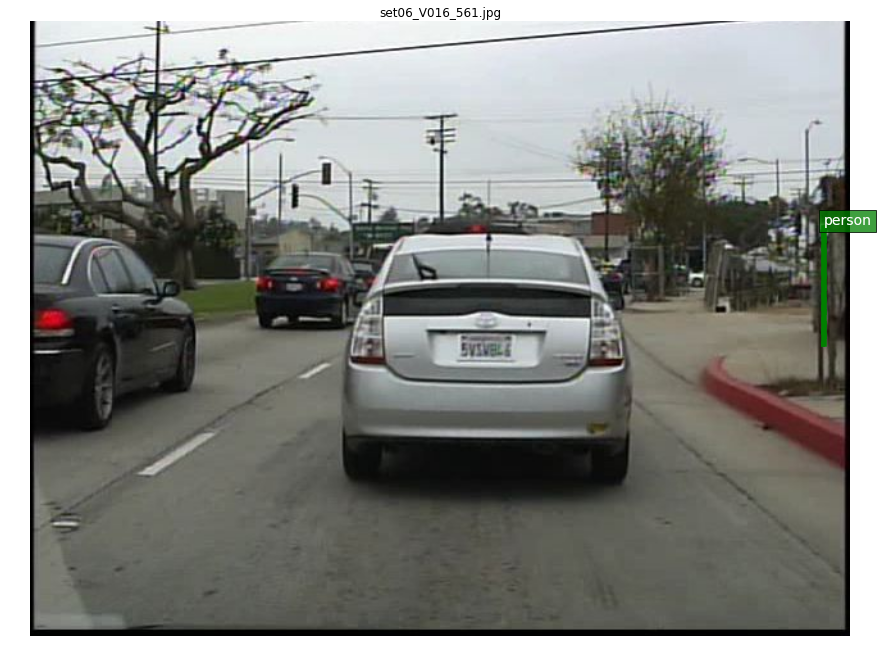

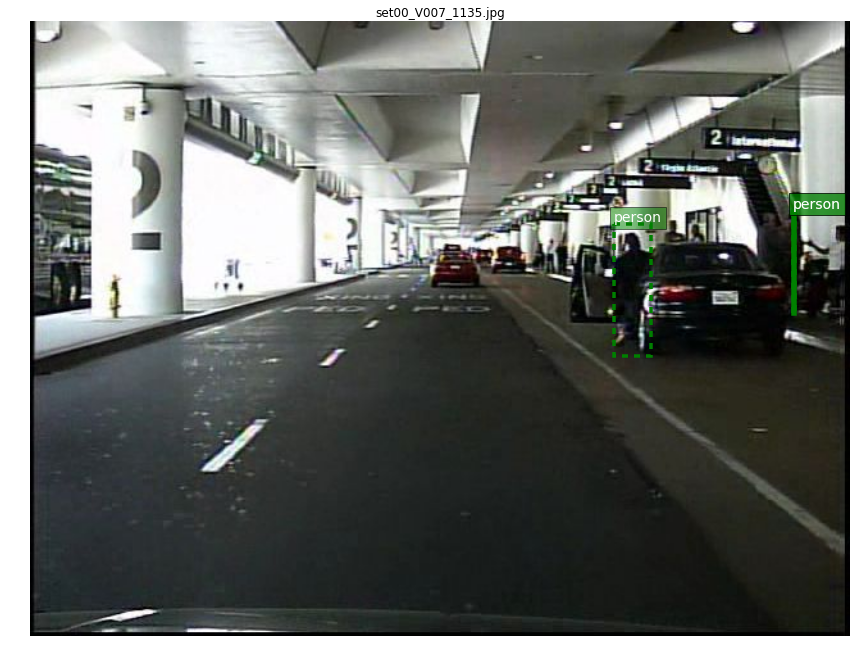

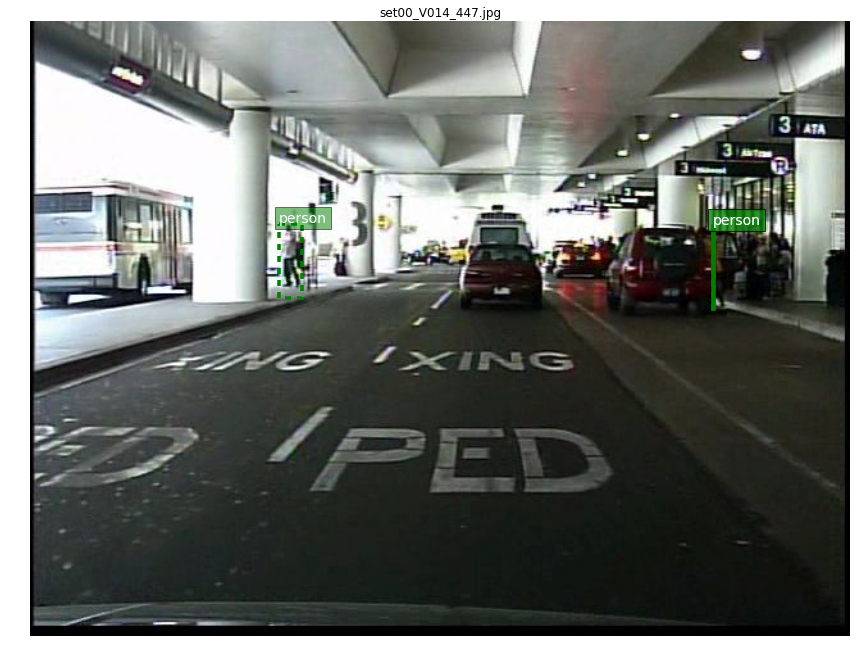

In [8]:
def reasonable_but_thin_filter(box):
    AR_ratio = {"min":0, "max": .2}
    return reasonable_filter(box) and aspect_ration_filter(box, AR_ratio)
                                          

verify_filter(reasonable_but_thin_filter, reasonable_filter)

1903 frames and 1969 bbox


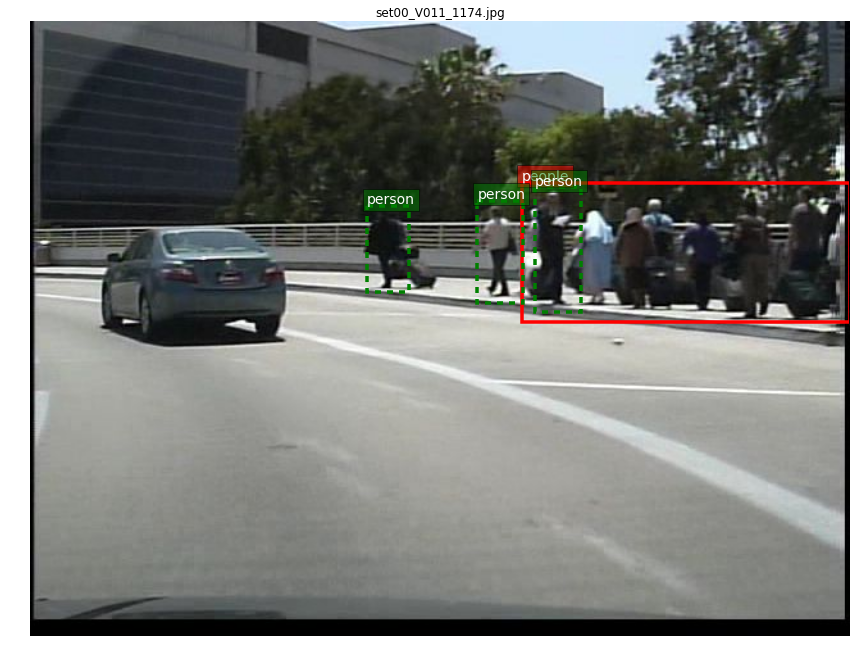

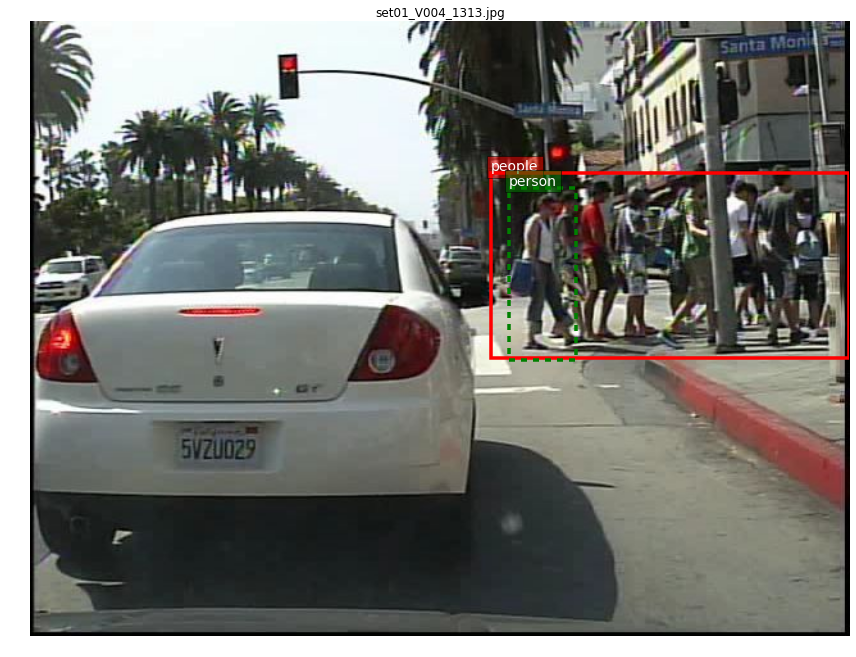

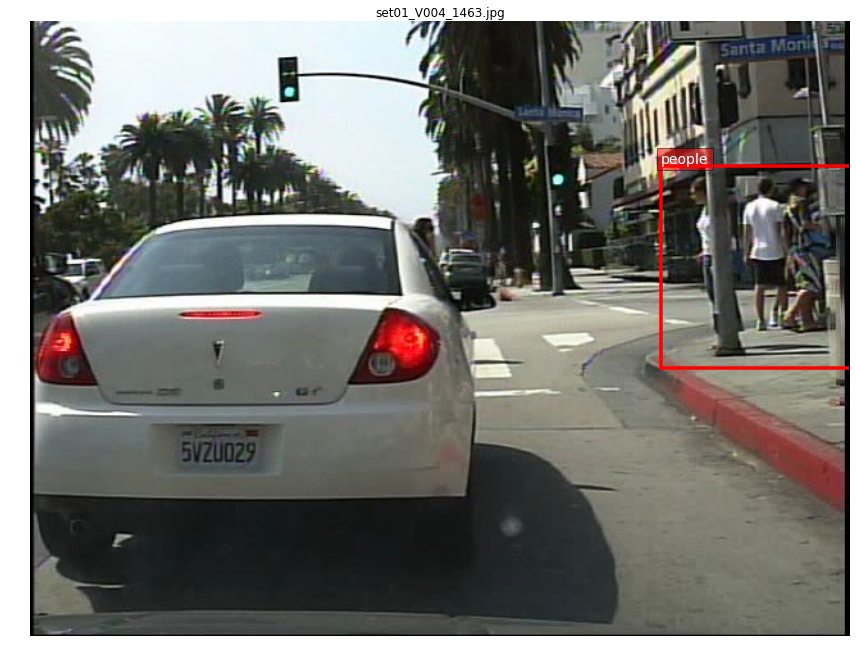

In [9]:
def big_people_filter(box):
    
    return box["lbl"] == "people" and box["pos"][3] > 100
                                          

verify_filter(big_people_filter, reasonable_filter)